In [1]:

import tensorflow_datasets as tfds
from prismatic import load # ?important for tfds to not cost GPU memory
from sklearn.linear_model import RANSACRegressor
import cv2
import matplotlib
import mediapy
from IPython import display
from PIL import Image
from matplotlib import pyplot as plt

2024-12-16 09:58:58.276535: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-16 09:58:58.276606: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-16 09:58:58.277479: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-16 09:58:58.283770: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-16 09:58:59.131012: W tensorflow/compiler/tf2

In [2]:
local_path="/home/lixiang/codebase/embodied-CoT/datasets/libero_new/libero_goal/1.0.0"
builder = tfds.builder_from_directory(builder_dir=local_path)
ds = builder.as_dataset(split=f'train[{0}%:{100}%]')


In [14]:
import h5py
import glob

paths = glob.glob("/home/lixiang/codebase/embodied-CoT/datasets/LIBERO/libero_spatial_failure_500try/*.hdf5")
for path in paths:
    with h5py.File(path, "r") as F:
        print(F['data'].keys())

<KeysViewHDF5 ['demo_1', 'demo_12', 'demo_13', 'demo_15', 'demo_17', 'demo_18', 'demo_28', 'demo_29', 'demo_33', 'demo_35', 'demo_38', 'demo_39', 'demo_41', 'demo_42', 'demo_49', 'demo_7']>
<KeysViewHDF5 ['demo_1', 'demo_11', 'demo_12', 'demo_13', 'demo_16', 'demo_17', 'demo_19', 'demo_24', 'demo_26', 'demo_3', 'demo_32', 'demo_33', 'demo_34', 'demo_36', 'demo_37', 'demo_45', 'demo_48', 'demo_49', 'demo_7']>
<KeysViewHDF5 ['demo_1', 'demo_10', 'demo_13', 'demo_14', 'demo_17', 'demo_19', 'demo_2', 'demo_20', 'demo_21', 'demo_25', 'demo_26', 'demo_27', 'demo_29', 'demo_4', 'demo_40', 'demo_42', 'demo_43', 'demo_45', 'demo_48', 'demo_7']>
<KeysViewHDF5 ['demo_0', 'demo_10', 'demo_12', 'demo_13', 'demo_14', 'demo_21', 'demo_26', 'demo_27', 'demo_3', 'demo_31', 'demo_33', 'demo_36', 'demo_37', 'demo_41', 'demo_42', 'demo_43', 'demo_45', 'demo_46', 'demo_47', 'demo_49', 'demo_5', 'demo_6']>
<KeysViewHDF5 ['demo_0', 'demo_12', 'demo_13', 'demo_16', 'demo_25', 'demo_39', 'demo_43', 'demo_49']>

In [4]:
for i, episode in enumerate(ds):
    episode_id = episode["episode_metadata"]["episode_id"].numpy()
    filename = episode["episode_metadata"]["file_path"].numpy().decode()
    if episode_id == 386:
        print(filename)
        break

/iris/u/moojink/prismatic-dev/LIBERO/libero/datasets/regenerated--no_noops/libero_goal/open_the_middle_drawer_of_the_cabinet_demo.hdf5


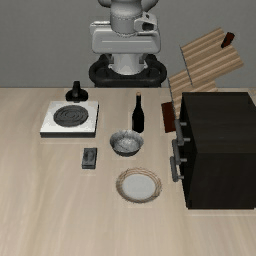

In [5]:
images = [step["observation"]['image'] for step in episode["steps"]]
images_1 = [Image.fromarray(image.numpy()) for image in images]
def as_gif(images, path=f'success_{episode_id}.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=50, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes
display.Image(as_gif(images_1))

# images_2 = [img.numpy() for img in images]
# mediapy.show_video(images_2, fps=10)

In [6]:
is_terminal = [step["is_terminal"].numpy() for step in episode["steps"]]
reward = [step["reward"].numpy()  for step in episode["steps"]]
print(is_terminal)
print(reward)

[False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, True]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

### use co-tracker to track gripper

In [7]:
import torch
import os
device = 'cuda:1'

cotracker = torch.hub.load(os.path.join(os.path.expanduser("~"), ".cache/torch/hub/facebookresearch_co-tracker_main/"), "cotracker3_offline", source="local").to(device)


In [8]:
images = [step["observation"]['image'] for step in episode["steps"]]
images_1 = [Image.fromarray(image.numpy()) for image in images]
images_tensor = [torch.from_numpy(tensor.numpy()) for tensor in images]
frame_tensor = torch.stack(images_tensor, dim=0)
frame_tensor = frame_tensor.permute(0, 3, 1, 2)[None].float().to(device) ## B T C H W
print(frame_tensor.shape)

torch.Size([1, 128, 3, 256, 256])


In [9]:
# it's better to track together
queries = torch.tensor([
    [0., 128., 45.],  # point tracked from the first frame
    [0., 128., 50.],
    [0., 128., 40.],
    [0., 123., 45.],
    [0., 133., 45.],
]).to(device)
print(queries.shape)

torch.Size([5, 3])


In [63]:
# it's better to track together
more_queries = torch.tensor([
    [0., 128., 45.],  # point tracked from the first frame
    [0., 128., 50.],
    [0., 128., 40.],
    [0., 123., 45.],
    [0., 133., 45.],
    [0., 123., 25.],
    [0., 128., 20.],
    [0., 128., 30.],
    [0., 128., 25.],
    [0., 133., 25.],
    [0., 143., 45.],
    [0., 143., 50.],
    [0., 143., 40.],
    [0., 138., 45.],
    [0., 148., 45.],
    [0., 113., 45.],
    [0., 113., 50.],
    [0., 113., 40.],
    [0., 118., 45.],
    [0., 107., 45.],
]).to(device)
print(more_queries.shape)

torch.Size([20, 3])


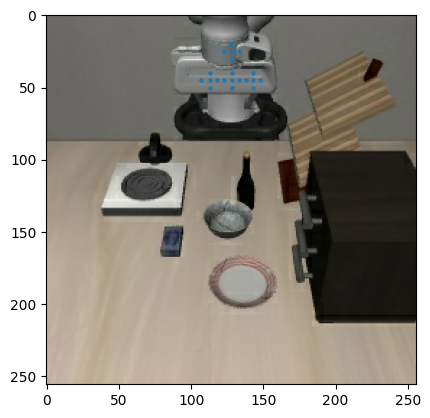

In [64]:
fig, ax = plt.subplots()

ax.scatter(more_queries[:, 1].cpu().numpy(), more_queries[:, 2].cpu().numpy(), s=5)
ax.imshow(images[0])



In [11]:
pred_tracks, pred_visibility = cotracker(frame_tensor, queries=queries[None])
print(pred_tracks.shape)
print(pred_visibility.shape)
#print(pred_visibility)

torch.Size([1, 128, 5, 2])
torch.Size([1, 128, 5])


In [12]:
c = pred_visibility[0,:,0].cpu().numpy()
colors = [(255,0,0) if i else (0,0,255) for i in c ]
print(colors)

[(255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (255, 0, 0), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255), (0, 0, 255)

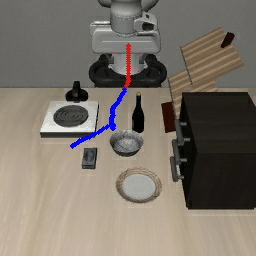

In [ ]:
track_points = pred_tracks[0,:,0,:] #[B, N, num_query, 2]
sample_interval = 1
track_points = track_points[::sample_interval]

images = [step["observation"]["image"] for step in episode["steps"]]
images = [img.numpy() for img in images]
for i, image in enumerate(images):
    point_index = i//sample_interval
    for j, p in enumerate(track_points[point_index:]):
        cv2.circle(image, (int(p[0]), int(p[1])), radius=2, color=colors[point_index+j], thickness=-1)

image_plt = [Image.fromarray(image) for image in images]
def as_gif(images, path=f'cotracker_vis/track_traj_{episode_id}_query5.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=50, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes
display.Image(as_gif(image_plt))

### long trajectory with interval

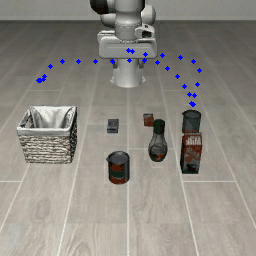

In [17]:
track_points = pred_tracks[0,:,0,:]
images = [step["observation"]["image"] for step in episode["steps"]]
images = [img.numpy() for img in images]
horizon = 150
sample_interval = 5
for i, image in enumerate(images):
    point_index = i//sample_interval
    for j in range(horizon//sample_interval):
        if i + j*sample_interval < len(track_points):
            p = track_points[i+j*sample_interval]
        else:
            p = p
        cv2.circle(image, (int(p[0]), int(p[1])), radius=2, color=(0, 0, 255), thickness=-1)

image_plt = [Image.fromarray(image) for image in images]
def as_gif(images, path=f'traj_{horizon}_{sample_interval}_{episode_id}.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=200, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes
display.Image(as_gif(image_plt))

### generate the trajectory of the gripper position using owlvit and sam

In [4]:
from utils import process_trajectory, get_corrected_positions, get_gripper_mask, get_bounding_boxes, show_box, mask_to_pos_naive, sq


Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


In [24]:
images = [step["observation"]["image"] for step in episode["steps"]]
frame = 0
img = Image.fromarray(images[frame].numpy())
predictions = get_bounding_boxes(img)
plot = True

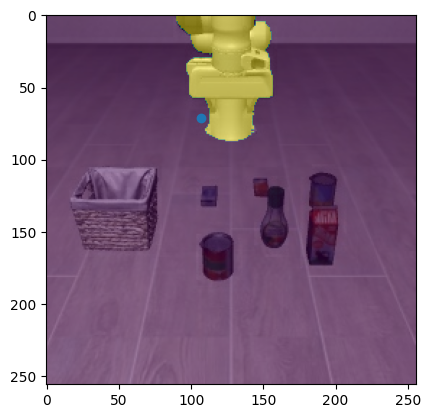

In [25]:
if plot:
    fig, ax = plt.subplots(1, 1)
    ax.imshow(img)

    for prediction in predictions:
        if prediction["score"] < 0.05:
            continue
        box = prediction["box"]
        show_box(box, ax, prediction, "red")
    if len(predictions) > 0:
        mask = get_gripper_mask(img, predictions[0])
        pos = mask_to_pos_naive(mask)
        

        if plot:
            plt.imshow(mask, alpha=0.5)
            plt.scatter([pos[0]], [pos[1]])
    else:
        print("No valid bounding box")

    if plot:
        plt.show()

In [8]:
t = process_trajectory(episode)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


In [11]:
import numpy as np
pos = [tr[0] for tr in t]
points_2d = np.array(pos, dtype=np.float32)
points_3d = np.array([tr[-1][:3] for tr in t])
points_3d_pr = np.concatenate([points_3d, np.ones_like(points_3d[:, :1])], axis=-1)
points_2d_pr = np.concatenate([points_2d, np.ones_like(points_2d[:, :1])], axis=-1)
reg = RANSACRegressor(random_state=0).fit(points_3d_pr, points_2d_pr)
pr_pos = reg.predict(points_3d_pr)[:, :-1].astype(int)


In [26]:
images = [step["observation"]["image"] for step in episode["steps"]]
images = [img.numpy() for img in images]

In [27]:
for i, image in enumerate(images):
    for p in pr_pos[i:]:
        cv2.circle(image, (int(p[0]), int(p[1])), radius=2, color=(0, 0, 255), thickness=-1)

image_plt = [Image.fromarray(image) for image in images]
def as_gif(images, path=f'temp_traj_{episode_id}.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=200, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes
display.Image(as_gif(image_plt))


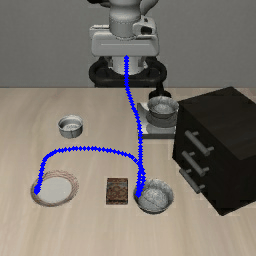

In [34]:
pr_pos.shape

(122, 2)

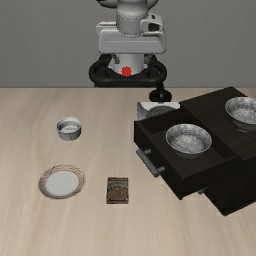

In [12]:

image_plt = [
    cv2.circle(img, (int(p[0]), int(p[1])), radius=5, color=(255, 0, 0), thickness=-1)
    for img, p in zip(images, pr_pos)
]

image_plt = [Image.fromarray(image) for image in image_plt]
def as_gif(images, path=f'temp_traj_{episode_id}.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=200, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes
display.Image(as_gif(image_plt))

### the origin version without cuda, very slow.

In [35]:
t = process_trajectory(episode)

In [14]:
import numpy as np
pos = [tr[0] for tr in t]
points_2d = np.array(pos, dtype=np.float32)
points_3d = np.array([tr[-1][:3] for tr in t])

In [15]:
points_3d_pr = np.concatenate([points_3d, np.ones_like(points_3d[:, :1])], axis=-1)
points_2d_pr = np.concatenate([points_2d, np.ones_like(points_2d[:, :1])], axis=-1)
reg = RANSACRegressor(random_state=0).fit(points_3d_pr, points_2d_pr)

In [18]:
pr_pos = reg.predict(points_3d_pr)[:, :-1].astype(int)

In [29]:
images = [step["observation"]["image"] for step in episode["steps"]]
images = [img.numpy() for img in images]
image_plt = [
    cv2.circle(img, (int(p[0])-20, int(p[1])), radius=5, color=(255, 0, 0), thickness=-1)
    for img, p in zip(images, pr_pos)
]

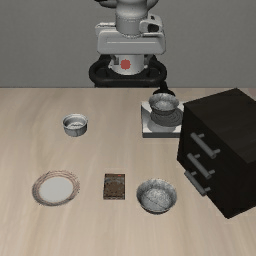

In [30]:
image_plt = [Image.fromarray(image) for image in image_plt]
def as_gif(images, path=f'temp_traj_{episode_id}.gif'):
  # Render the images as the gif:
  images[0].save(path, save_all=True, append_images=images[1:], duration=200, loop=0)
  gif_bytes = open(path,'rb').read()
  return gif_bytes
display.Image(as_gif(image_plt))